### `3.1 Data Processing and spliting dataset along with normaizign and standardizing`

In [10]:
import numpy as np
import pandas as pd
from sklearn.datasets import load_wine
from matplotlib import pyplot
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import KNNImputer
import wandb
import matplotlib.pyplot as plt


             CRIM          ZN       INDUS        CHAS         NOX          RM  \
count  486.000000  486.000000  486.000000  486.000000  506.000000  506.000000   
mean     3.611874   11.211934   11.083992    0.069959    0.554695    6.284634   
std      8.720192   23.388876    6.835896    0.255340    0.115878    0.702617   
min      0.006320    0.000000    0.460000    0.000000    0.385000    3.561000   
25%      0.081900    0.000000    5.190000    0.000000    0.449000    5.885500   
50%      0.253715    0.000000    9.690000    0.000000    0.538000    6.208500   
75%      3.560263   12.500000   18.100000    0.000000    0.624000    6.623500   
max     88.976200  100.000000   27.740000    1.000000    0.871000    8.780000   

              AGE         DIS         RAD         TAX     PTRATIO           B  \
count  486.000000  506.000000  506.000000  506.000000  506.000000  506.000000   
mean    68.518519    3.795043    9.549407  408.237154   18.455534  356.674032   
std     27.999513    2.1057

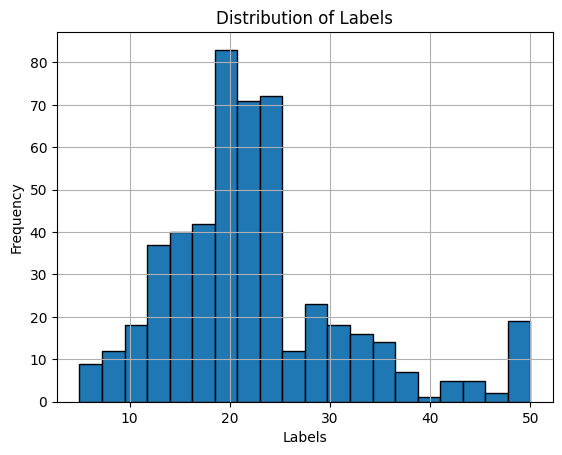

In [11]:

data = pd.read_csv('HousingData.csv')
# print(data.head())
print(data.describe())
# print(data.isnull().sum())

labels = pd.DataFrame(data.MEDV)
data = data.drop(columns=['MEDV'], axis=1)

#Filling the empty value's with Mean
imputer = KNNImputer(n_neighbors=2, weights="uniform")
data = imputer.fit_transform(data)
print(data.shape)
# print(labels.shape)

labels = labels.values

print(len(labels))

print("DATA is:", data )
print("Labels are", labels)

plt.hist(labels, bins=20, edgecolor='k')  # Adjust the number of bins as needed
plt.xlabel('Labels')
plt.ylabel('Frequency')
plt.title('Distribution of Labels')
plt.grid(True)


In [12]:
def normalise(data):
    data = (data - data.min())/(data.max()-data.min())
    return data

In [13]:
def standardize(data):
    data = (data - data.mean())/data.std()
    return data

In [14]:
data = normalise(data) 
data = standardize(data)
print(data)

[[-0.48273905 -0.35877418 -0.46686818 ... -0.37737544  2.2516029
  -0.4484736 ]
 [-0.48259445 -0.4827826  -0.43407485 ... -0.36015205  2.2516029
  -0.41981388]
 [-0.48259459 -0.4827826  -0.43407485 ... -0.36015205  2.22356322
  -0.45501849]
 ...
 [-0.482364   -0.4827826  -0.40059258 ... -0.33810611  2.2516029
  -0.44392663]
 [-0.48202759 -0.4827826  -0.40059258 ... -0.33810611  2.22783462
  -0.43813957]
 [-0.48245597 -0.4827826  -0.40059258 ... -0.33810611  2.2516029
  -0.42849447]]


In [15]:

# print(labels,data)
X_train , X_test , y_train , y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

In [16]:
print(y_train.sum())

9209.8


### `3.2 Implemented MLP Regression class + W&B implemented in class`

Implemented:
1. Created a class where you can modify and access the learning rate, activa-tion function, optimisers, number of hidden layers and neurons.
2. Implement methods for forward propagation, backpropagation, and train-ing.
3. Implement the Sigmoid, Tanh, and ReLU activation functions and make
them easily interchangeable within your MLP framework.
4. Implement methods for the Stochastic Gradient Descent (SGD), Batch
Gradient Descent, and Mini-Batch Gradient Descent algorithms from scratch,ensuring that they can be employed within your MLP architecture.

In [17]:
class Multi_layer_perceptron_wb():
    def __init__(self,data, labels,  hiddenLayers=[3], OutputLayer=1, learningRate = 0.001, activation = "sigmoid"):
        # encoder = OneHotEncoder(sparse_output=False)
        # self.labels = encoder.fit_transform(labels)
        self.labels = labels
        self.data = data
        self.action = activation
        self.inputLayer = data.shape[1]
        self.learningRate = learningRate
        self.outputLayer = OutputLayer
        self.hiddenLayer = hiddenLayers
        print(self.inputLayer, self.outputLayer, self.hiddenLayer)
        #required number of weight vector's = hiddenLayers.size()+1
        self.we = [] 
        
        W1 = np.random.randn(self.inputLayer, self.hiddenLayer[0])
        self.we.append(W1)

        self.numberOfHiddenLayers = len(hiddenLayers)

        for i in range (1, self.numberOfHiddenLayers):
            W1 = np.random.randn(self.hiddenLayer[i-1], self.hiddenLayer[i])
            self.we.append(W1)

        W2 = np.random.randn(self.hiddenLayer[-1], self.outputLayer)
        self.we.append(W2)
        print(len(self.we))
        print(W1.shape,W2.shape)

    def activation(self,z):
        if(self.action == "sigmoid"):
            return 1/(1+np.exp(-z))
        if(self.action == "tanh"):
            return np.tanh(z)
        if(self.action == "Relu"):
            # return z*(z>0)
            return np.maximum(0,z)

    def derivative(self,z):
        if(self.action == "sigmoid"):
            return np.exp(-z)/((1+np.exp(-z))**2)
        if(self.action == "tanh"):
            return 1 - z**2
        if(self.action == "Relu"):
            # return 1*(z>0)
            return np.where(z>0 , 1 , 0)
    
  
    def forward(self,X):
        #number z's and a's will be self.numberOfHiddenLayers+1
        self.a = []
        self.z = []
        
        self.z.append( np.dot(X, self.we[0]) )
        self.a.append( self.activation(self.z[0] ))

        for i in range(1, self.numberOfHiddenLayers+1):
            self.z.append(  np.dot(self.a[i-1], self.we[i])  ) 
            self.a.append(  self.activation(self.z[i]) )

        return self.a[-1]
    
    def backward(self, data_batch, labels_batch):
        djdw = []

        # Forward pass
        self.forward(data_batch)

        # Compute output layer error
        delta = np.multiply(-(labels_batch - self.a[-1]), self.derivative(self.z[-1]))

        # Backpropagation through hidden layers
        for i in range(self.numberOfHiddenLayers):
            curr_idx = self.numberOfHiddenLayers - i - 1
            jw = np.dot(self.a[curr_idx].T, delta)
            djdw.insert(0, jw)
            delta = np.dot(delta, self.we[curr_idx + 1].T) * self.derivative(self.z[curr_idx])

        # Compute the gradient for the input layer
        jw = np.dot(data_batch.T, delta)
        djdw.insert(0, jw)

        return djdw

    def gradient_descent(self, djdw):
        n = len(self.data)
        for i in range(len(self.we)):
            self.we[i] -= (self.learningRate / n) * djdw[i]

    def fit(self, num_epochs=20000,  batch_size = 0):
        num_samples = len(self.data)
       
        for epoch in range(num_epochs):
            if batch_size == 0:  # Full Batch Gradient Descent
                data_batch, labels_batch = self.data, self.labels
                djdw = self.backward(data_batch, labels_batch)
                self.gradient_descent(djdw)
            else:  # Mini-Batch Gradient Descent or Stochastic Gradient Descent
                indices = np.arange(num_samples)
                np.random.shuffle(indices)

                for i in range(0, num_samples, batch_size):
                    batch_indices = indices[i:i + batch_size]
                    data_batch = self.data[batch_indices]
                    labels_batch = self.labels[batch_indices]
                    djdw = self.backward(data_batch, labels_batch)
                    self.gradient_descent(djdw)

            output_labels = self.forward(self.data)
            error = ((output_labels - self.labels) ** 2).sum()
            ss = 0
            
            wandb.log({"Learning_Rate": self.learningRate, "num_epoches": num_epochs, "batch_size": batch_size})
            wandb.log({"MSE": error/2, "RMSE": np.sqrt(error), "R-squared": 1 - (error / np.var(self.labels))})

            print("Epoch {}: Error = {}".format(epoch, error))


In [18]:
# obj = Multi_layer_perceptron_wb(data = X_train , labels=y_train, hiddenLayers=[6,5,7], learningRate=0.001, activation='Relu', OutputLayer=1, batch_size=32)
# obj.forward(X_train)
# print(obj.a[-1])
# print(obj.a[-1])
# obj.backward()

wandb.init(project="SAMI-Ass-3-3", entity='aryamarda')

for learningRate in [0.005 , 0.001]:
    for hiddenLayers in [[6], [6,3], [6,5,7] ]:
        for num_epochs in [1500, 10000, 20000]:
            for batch_size in [0, 32, 50]:
                obj = Multi_layer_perceptron_wb(data = X_train , labels=y_train, hiddenLayers=hiddenLayers, learningRate=learningRate, activation='Relu', OutputLayer=1)
                obj.fit(num_epochs=num_epochs, batch_size=batch_size)
# obj.fit(num_epochs=15000)

Learning_Rate,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
MSE,██████████▁▁▁▁▁▁▁▁▁▁██████████▁▁▁▁▁▁▁▁▁▁
R-squared,▁▁▁▁▁▁▁▁▁▁██████████▁▁▁▁▁▁▁▁▁▁██████████
RMSE,██████████▂▁▁▁▁▁▁▁▁▁██████████▂▁▁▁▁▁▁▁▁▁
batch_size,▁▁▁▁▁▁▁▁▁▁▅▅▅▅▅▅▅▅▅▅██████████▁▁▁▁▁▁▁▁▁▁
hidden_layers,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
num_epoches,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁██████████
Learning_Rate,0.005
MSE,10820.84903
R-squared,-248.11765
RMSE,147.11118


13 1 [6]
2
(13, 6) (6, 1)
Epoch 0: Error = 245048.38
Epoch 1: Error = 245048.38
Epoch 2: Error = 245048.38
Epoch 3: Error = 245048.38
Epoch 4: Error = 245048.38
Epoch 5: Error = 245048.38
Epoch 6: Error = 245048.38
Epoch 7: Error = 245048.38
Epoch 8: Error = 245048.38
Epoch 9: Error = 245048.38
Epoch 10: Error = 245048.38
Epoch 11: Error = 245048.38
Epoch 12: Error = 245048.38
Epoch 13: Error = 245048.38
Epoch 14: Error = 245048.38
Epoch 15: Error = 245048.38
Epoch 16: Error = 245048.38
Epoch 17: Error = 245048.38
Epoch 18: Error = 245048.38
Epoch 19: Error = 245048.38
Epoch 20: Error = 245048.38
Epoch 21: Error = 245048.38
Epoch 22: Error = 245048.38
Epoch 23: Error = 245048.38
Epoch 24: Error = 245048.38
Epoch 25: Error = 245048.38
Epoch 26: Error = 245048.38
Epoch 27: Error = 245048.38
Epoch 28: Error = 245048.38
Epoch 29: Error = 245048.38
Epoch 30: Error = 245048.38
Epoch 31: Error = 245048.38
Epoch 32: Error = 245048.38
Epoch 33: Error = 245048.38
Epoch 34: Error = 245048.38
Epoc

In [19]:
print(obj.a[-1])

[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.